# Bibliotecas

In [2]:
!pip install xmltodict

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

MessageError: ignored

In [ ]:
import pandas as pd
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
import xmltodict
from xml.dom import minidom
import os

# Dataset A

In [ ]:
#A
datasetA_xml = open("/content/drive/MyDrive/TFM/A_Dataset/Dron_Anotaciones.xgtf").read()
A_dict = xmltodict.parse(datasetA_xml)
A_list = A_dict['viper']['data']['sourcefile']['object']

A_list es una lista de diccionarios, cada diccionario es un objeto de la imágenes con claves:  

*   @framespan: intervalo de imágenes en las que aparece
*   @id: identificador del objeto (un número)
*   @name: Car, Motorbike o Bus
*   attribute: es una lista con 2 diccionarios dentro:
  *   Posición 0 de la lista: el diccionario tiene 2 claves: @name que no sirve y 'data:svalue' que con tiene un diccionario con una clave @value que contiene el nombre del objeto (Ej: Moto1, car3, truck2..., ojo algunos en mayúscula y otros en minúscula)
  *   Posición 1 de la lista: tiene dos claves: @name que tampoco sirve y una lista 'data:bbox' que es una lista de diccionarios con las siguientes claves:
      *   @framespan: intervalo de imágenes en las que aparece el objeto en la misma posición.
      *   @height: altura del marco del objeto
      *   @width: ancho del marco del objeto
      *   @x: coordenada x de una esquina
      *   @y: coordenada y de una esquina









In [ ]:
#CSV intermedio para almacenar los parámetros relevantes con los datos sin normalizar
image_height = 364
image_width = 640
classes = {
    'motorbike': 0,
    'car': 1,
    'bus': 2,
}
datasetA_df = pd.DataFrame(columns = ['frame','class','class_label','object','top_left_x', 'top_left_y','width','height'])
for obj in A_list:
    class_type = obj['@name'].lower()
    unique_object = obj['attribute'][0]['data:svalue']['@value'].lower()
    for bbox in obj['attribute'][1]['data:bbox']:
            framespan = bbox['@framespan'].split(" ")
            x = bbox['@x']
            y = bbox['@y']
            width = bbox['@width']
            height = bbox['@height']
            for frame in framespan:
              numbers = [int(x) for x in frame.strip("[]'").split(':')]
              for i in range(numbers[0], numbers[1]+1):
                  row = {
                      'frame': str(i).zfill(6),
                      'class': class_type,
                      'class_label': classes[class_type],
                      'object': unique_object,
                      'top_left_x': int(x),
                      'top_left_y': int(y),
                      'width': int(width),
                      'height': int(height),
                  }
                  datasetA_df = datasetA_df.append(row, ignore_index=True)

datasetA_df.to_csv('/content/drive/MyDrive/TFM/Anotaciones_sin_normalizar_datasetA.csv')

In [ ]:
#CSV intermedio para almacenar los parámetros relevantes con los datos normalizados
image_height = 364
image_width = 640
classes = {
    'motorbike': 0,
    'car': 1,
    'bus': 2,
}
datasetA_df = pd.DataFrame(columns = ['frame','class','class_label','object','top_left_x', 'top_left_y','width','height'])
for obj in A_list:
    class_type = obj['@name'].lower()
    unique_object = obj['attribute'][0]['data:svalue']['@value'].lower()
    for bbox in obj['attribute'][1]['data:bbox']:
            framespan = bbox['@framespan'].split(" ")
            x = bbox['@x']
            y = bbox['@y']
            width = bbox['@width']
            height = bbox['@height']
            for frame in framespan:
              numbers = [int(x) for x in frame.strip("[]'").split(':')]
              for i in range(numbers[0], numbers[1]+1):
                  row = {
                      'frame': str(i).zfill(6),
                      'class': class_type,
                      'class_label': classes[class_type],
                      'object': unique_object,
                      'top_left_x': int(x)/image_width,
                      'top_left_y': int(y)/image_height,
                      'width': int(width)/image_width,
                      'height': int(height)/image_height,
                  }
                  datasetA_df = datasetA_df.append(row, ignore_index=True)

datasetA_df.to_csv('/content/drive/MyDrive/TFM/Anotaciones_datasetA.csv')

In [ ]:
datasetA_df = pd.read_csv('/content/drive/MyDrive/TFM/Anotaciones_datasetA.csv')

In [ ]:
#CSV a formato YOLO
for i in range(len(datasetA_df)):
    with open('/content/drive/MyDrive/TFM/A_Dataset/' + datasetA_df.iloc[i]['frame'] +".txt", 'a') as file:
        file.write(f"{datasetA_df.iloc[i]['class_label']} {float(datasetA_df.iloc[i]['top_left_x']) + float(datasetA_df.iloc[i]['width'])/2} {float(datasetA_df.iloc[i]['top_left_y']) + float(datasetA_df.iloc[i]['height'])/2} {datasetA_df.iloc[i]['width']} {datasetA_df.iloc[i]['height']}" + '\n')

# Etiquetar imagenes (visualización)

In [ ]:
datasetA_df = pd.read_csv('/content/drive/MyDrive/TFM/Anotaciones_sin_normalizar_datasetA.csv')
datasetB_df = pd.read_csv('/content/drive/MyDrive/TFM/Anotaciones_sin_normalizar_datasetB.csv')
datasetC_df = pd.read_csv('/content/drive/MyDrive/TFM/Anotaciones_sin_normalizar_datasetC.csv')
mapping_dictA = {'car': 'Light Vehicle', 'bus': 'Heavy Vehicle', 'motorbike':'Motorbike'}
mapping_dict = {'car': 'Light Vehicle', 'bus': 'Heavy Vehicle', 'moto':'Motorbike'}
datasetA_df['class'] = datasetA_df['class'].map(mapping_dictA)
datasetB_df['class'] = datasetB_df['class'].map(mapping_dict)
datasetC_df['class'] = datasetC_df['class'].map(mapping_dict)

<ipython-input-71-1ab25584145f>:3: DtypeWarning: Columns (1,3,5,6,7,8) have mixed types. Specify dtype option on import or set low_memory=False.
  datasetC_df = pd.read_csv('/content/drive/MyDrive/TFM/Anotaciones_sin_normalizar_datasetC.csv')


In [ ]:
import cv2
from google.colab.patches import cv2_imshow
def plot_imageA(df, imagen):
    color_dict = {
      0: (255,0,0),
      1: (0, 255, 0),  # Verde para Light Vehicle
      2: (0, 0, 255)   # Azul para Heavy Vehicle
    }
    for index, row in df.iterrows():
      x, y, w, h = int(row['top_left_x']), int(row['top_left_y']), int(row['width']), int(row['height'])
      class_label = row['class_label']
      class_name = str(row['class'])

      # Obtener el color para la clase actual
      color = color_dict.get(class_label, (0, 0, 0))  # Si no se encuentra el color, se usa negro

      # Dibuja el recuadro delimitador y el nombre de la clase
      cv2.rectangle(imagen, (x, y), (x + w, y + h), color, 2)
      #cv2.putText(imagen, class_name, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)
    cv2_imshow(imagen)

def plot_image(df, imagen):
    color_dict = {
      0: (255,0,0),
      1: (0, 255, 0),  # Verde para Light Vehicle
      2: (0, 0, 255)   # Azul para Heavy Vehicle
    }
    for index, row in df.iterrows():
      x, y, w, h = int(row['top_left_x'])*2, int(row['top_left_y'])*2, int(row['width'])*2, int(row['height'])*2
      class_label = row['class_label']
      class_name = str(row['class'])

      # Obtener el color para la clase actual
      color = color_dict.get(class_label, (0, 0, 0))  # Si no se encuentra el color, se usa negro

      # Dibuja el recuadro delimitador y el nombre de la clase
      cv2.rectangle(imagen, (x, y), (x + w, y + h), color, 2)
      #cv2.putText(imagen, class_name, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 1, color, 3)
    cv2_imshow(imagen)

In [ ]:
imagenA = cv2.imread('/content/drive/MyDrive/TFM/A_Split80_10_10/evaluation/images/000010.jpg')
imagenB = cv2.imread('/content/drive/MyDrive/TFM/B_Split_80_10_10/evaluation/images/v1_021868.jpg')
imagenC = cv2.imread('/content/drive/MyDrive/TFM/C_Split_80_10_10/evaluation/images/v2_006720.jpg')
dfA = datasetA_df[datasetA_df['frame'] == 10]
dfB = datasetB_df[datasetB_df['frame'] == 21868]
dfC = datasetC_df[datasetC_df['frame'] == 6720]

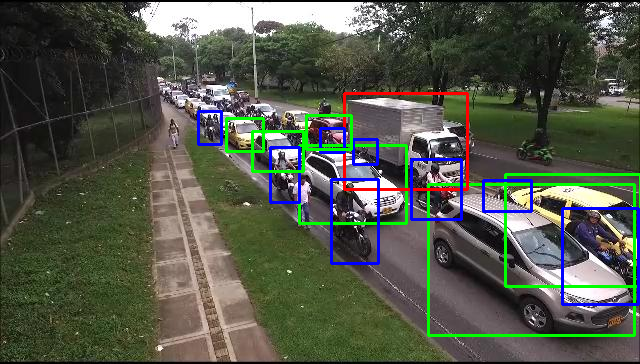

In [ ]:
plot_imageA(dfA, imagenA)

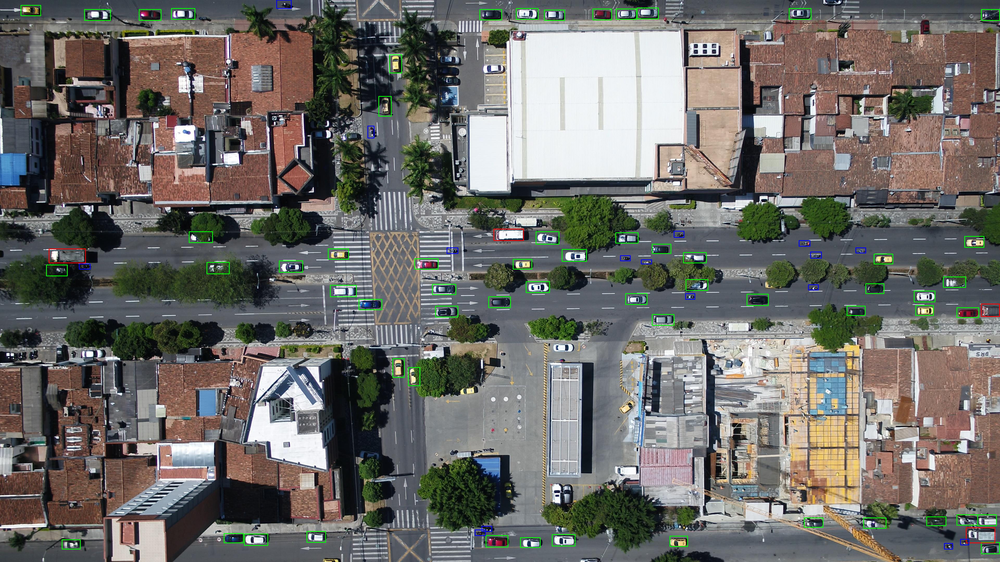

In [ ]:
plot_image(dfB, imagenB)

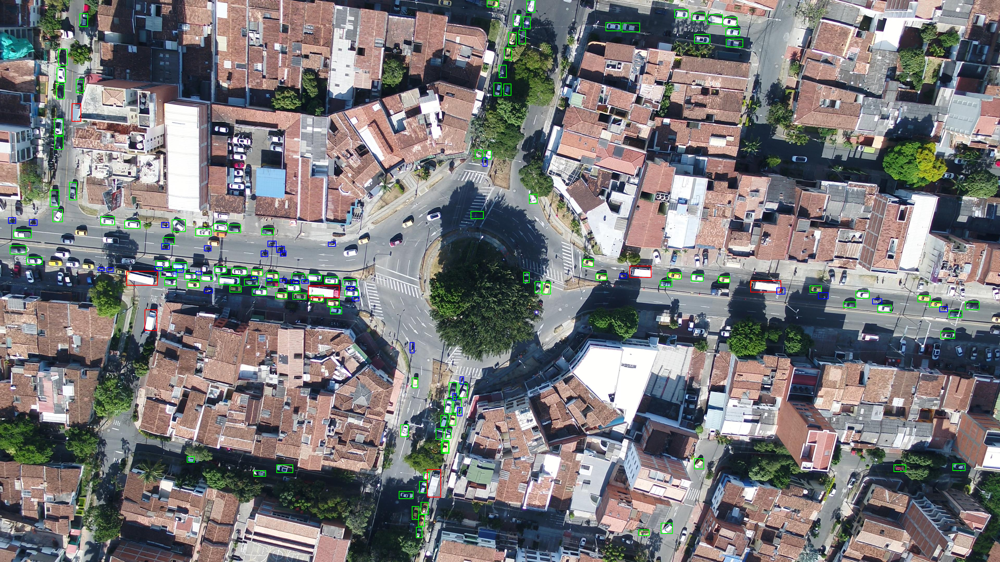

In [ ]:
plot_image(dfC, imagenC)

# Dataset B

In [ ]:
#B
datasetB1_xml = open("/content/drive/MyDrive/TFM/B_Dataset/video1_jorge_carros_buses.xgtf").read()
datasetB2_xml = open("/content/drive/MyDrive/TFM/B_Dataset/video1_jorge_motos.xgtf").read()
B1_dict = xmltodict.parse(datasetB1_xml)
B1_list = B1_dict['viper']['data']['sourcefile']['object']
B2_dict = xmltodict.parse(datasetB2_xml)
B2_list = B2_dict['viper']['data']['sourcefile']['object']
B_list = B1_list + B2_list

In [ ]:
images=[]
images_dict = {}
for i in range(20000,30000):
  if os.path.exists('/content/drive/MyDrive/TFM/B_Dataset/v1_'+str(i).zfill(6)+".jpg"):
      images.append(i)
images.sort()
for i in range(1,6501):
  images_dict[str(i)] = images[i-1]

In [ ]:
#CSV intermedio para almacenar los parámetros relevantes
image_height = 1080
image_width = 1920
classes = {
    'moto': 0,
    'car': 1,
    'bus': 2,
}
datasetB_df = pd.DataFrame(columns = ['frame','class','class_label','object','top_left_x', 'top_left_y','width','height'])
for obj in B_list:
    class_type = obj['@name'].lower()
    unique_object = obj['attribute'][1]['data:svalue']['@value'].lower()
    for bbox in obj['attribute'][0]['data:bbox']:
            framespan = bbox['@framespan'].split(" ")
            x = bbox['@x']
            y = bbox['@y']
            width = bbox['@width']
            height = bbox['@height']
            for frame in framespan:
              numbers = [int(x) for x in frame.strip("[]'").split(':')]
              for i in range(numbers[0], numbers[1]+1):
                  row = {
                      'frame': str(images_dict[str(i)]).zfill(6),
                      'class': class_type,
                      'class_label': classes[class_type],
                      'object': unique_object,
                      'top_left_x': int(x),
                      'top_left_y': int(y),
                      'width': int(width),
                      'height': int(height),
                  }
                  datasetB_df = datasetB_df.append(row, ignore_index=True)

datasetB_df.to_csv('/content/drive/MyDrive/TFM/Anotaciones_sin_normalizar_datasetB.csv')
print('done')

In [ ]:
datasetB_df = pd.read_csv('/content/drive/MyDrive/TFM/Anotaciones_sin_normalizar_datasetB.csv')

In [ ]:
#CSV a formato YOLO
for i in range(len(datasetB_df)):
    with open('/content/drive/MyDrive/TFM/B_Dataset/v1_' + datasetB_df.iloc[i]['frame'] +".txt", 'a') as file:
        file.write(f"{datasetB_df.iloc[i]['class_label']} {float(datasetB_df.iloc[i]['top_left_x']) + float(datasetB_df.iloc[i]['width'])/2} {float(datasetB_df.iloc[i]['top_left_y']) + float(datasetB_df.iloc[i]['height'])/2} {datasetB_df.iloc[i]['width']} {datasetB_df.iloc[i]['height']}" + '\n')

# Dataset C

In [ ]:
etiquetado_xml = open("/content/drive/MyDrive/TFM/C_Dataset/etiquetado.xgtf").read()
etiquetado_dict = xmltodict.parse(etiquetado_xml)
etiquetado_list = etiquetado_dict['viper']['data']['sourcefile']['object']

VideoF_xml = open("/content/drive/MyDrive/TFM/C_Dataset/VideoF.xgtf").read()
VideoF_dict = xmltodict.parse(VideoF_xml)
VideoF_list = VideoF_dict['viper']['data']['sourcefile']['object']

lcarrosfinal_xml = open("/content/drive/MyDrive/TFM/C_Dataset/lcarrosfinal.xgtf").read()
lcarrosfinal_dict = xmltodict.parse(lcarrosfinal_xml)
lcarrosfinal_list = lcarrosfinal_dict['viper']['data']['sourcefile']['object']
lmotosybuses_xml = open("/content/drive/MyDrive/TFM/C_Dataset/lmotosybuses.xgtf").read()
lmotosybuses_dict = xmltodict.parse(lmotosybuses_xml)
lmotosybuses_list = lmotosybuses_dict['viper']['data']['sourcefile']['object']
laura_list = lcarrosfinal_list + lmotosybuses_list

In [ ]:
#diccionario etiquetado
images=[]
images_dict_etiquetado = {}
for i in range(20000,30000):
  if os.path.exists('/content/drive/MyDrive/TFM/C_Dataset/v2_'+str(i).zfill(6)+".jpg"):
      images.append(i)
images.sort()
for i in range(1,2201):
  images_dict_etiquetado[str(i)] = images[i-1]

In [ ]:
#diccionario laura
images=[]
images_dict_laura = {}
for i in range(6700,10056):
  if os.path.exists('/content/drive/MyDrive/TFM/C_Dataset/v2_'+str(i).zfill(6)+".jpg"):
      images.append(i)
images.sort()
for i in range(1,3352):
  images_dict_laura[str(i)] = images[i-1]

In [ ]:
#diccionario videoF
images=[]
images_dict_videof = {}
for i in range(10056,20000):
  if os.path.exists('/content/drive/MyDrive/TFM/C_Dataset/v2_'+str(i).zfill(6)+".jpg"):
      images.append(i)
images.sort()
for i in range(1,2201):
  images_dict_videof[str(i)] = images[i-1]

In [ ]:
#CSV intermedio para almacenar los parámetros relevantes
image_height = 1080
image_width = 1920
classes = {
    'moto': 0,
    'car': 1,
    'bus': 2,
}
datasetC_df = pd.DataFrame(columns = ['frame','class','class_label','object','top_left_x', 'top_left_y','width','height'])

#etiquetado.xgtf
for obj in etiquetado_list:
    class_type = obj['@name'].lower()
    unique_object = obj['attribute'][1]['data:svalue']['@value'].lower()
    for bbox in obj['attribute'][0]['data:bbox']:
            framespan = bbox['@framespan'].split(" ")
            x = bbox['@x']
            y = bbox['@y']
            width = bbox['@width']
            height = bbox['@height']
            for frame in framespan:
              numbers = [int(x) for x in frame.strip("[]'").split(':')]
              if numbers[0]<=2200:
                for i in range(numbers[0], numbers[1]+1):
                  if i<=2200:
                    row = {
                        'frame': str(images_dict_etiquetado[str(i)]).zfill(6),
                        'class': class_type,
                        'class_label': classes[class_type],
                        'object': unique_object,
                        'top_left_x': int(x),
                        'top_left_y': int(y),
                        'width': int(width),
                        'height': int(height),
                    }
                    datasetC_df = datasetC_df.append(row, ignore_index=True)


image_height = 1080
image_width = 1920
datasetC_df.to_csv('/content/drive/MyDrive/TFM/Anotaciones_sin_normalizar_datasetC.csv')
print('etiquetado')
#datasetC_df = datasetC_df.drop(datasetC_df.index, inplace=True)
datasetC_df = pd.DataFrame(columns = ['frame','class','class_label','object','top_left_x', 'top_left_y','width','height'])
for obj in laura_list:
    class_type = obj['@name'].lower()
    unique_object = obj['attribute'][0]['data:svalue']['@value'].lower()
    if (type(obj['attribute'][1]['data:bbox']) == list):
      for bbox in obj['attribute'][1]['data:bbox']:
              framespan = bbox['@framespan'].split(" ")
              x = bbox['@x']
              y = bbox['@y']
              width = bbox['@width']
              height = bbox['@height']
              for frame in framespan:
                numbers = [int(x) for x in frame.strip("[]'").split(':')]
                if numbers[0]<=2200:
                  for i in range(numbers[0], numbers[1]+1):
                    if i<=2200:
                      row = {
                          'frame': str(images_dict_laura[str(i)]).zfill(6),
                          'class': class_type,
                          'class_label': classes[class_type],
                          'object': unique_object,
                          'top_left_x': int(x),
                          'top_left_y': int(y),
                          'width': int(width),
                          'height': int(height),
                      }
                      datasetC_df = datasetC_df.append(row, ignore_index=True)
    else:
              framespan = obj['attribute'][1]['data:bbox']['@framespan'].split(" ")
              x = obj['attribute'][1]['data:bbox']['@x']
              y = obj['attribute'][1]['data:bbox']['@y']
              width = obj['attribute'][1]['data:bbox']['@width']
              height = obj['attribute'][1]['data:bbox']['@height']
              for frame in framespan:
                numbers = [int(x) for x in frame.strip("[]'").split(':')]
                if numbers[0]<=2200:
                  for i in range(numbers[0], numbers[1]+1):
                    if i<=2200:
                      row = {
                          'frame': str(images_dict_laura[str(i)]).zfill(6),
                          'class': class_type,
                          'class_label': classes[class_type],
                          'object': unique_object,
                          'top_left_x': int(x),
                          'top_left_y': int(y),
                          'width': int(width),
                          'height': int(height),
                      }
                      datasetC_df = datasetC_df.append(row, ignore_index=True)


classes = {
    'dmoto': 0,
    'dcar': 1,
    'dbus': 2,
}
datasetC_df.to_csv('/content/drive/MyDrive/TFM/Anotaciones_sin_normalizar_datasetC.csv', mode='a')
print('laura')
#datasetC_df = datasetC_df.drop(datasetC_df.index, inplace=True)
datasetC_df = pd.DataFrame(columns = ['frame','class','class_label','object','top_left_x', 'top_left_y','width','height'])
for obj in VideoF_list:
    class_type = obj['@name'].lower()
    unique_object = obj['attribute'][1]['data:svalue']['@value'].lower()
    if (type(obj['attribute'][0]['data:bbox']) == list):
      for bbox in obj['attribute'][0]['data:bbox']:
              framespan = bbox['@framespan'].split(" ")
              x = bbox['@x']
              y = bbox['@y']
              width = bbox['@width']
              height = bbox['@height']
              for frame in framespan:
                numbers = [int(x) for x in frame.strip("[]'").split(':')]
                if numbers[0]<=2200:
                  for i in range(numbers[0], numbers[1]+1):
                    if i<=2200:
                      row = {
                          'frame': str(images_dict_videof[str(i)]).zfill(6),
                          'class': class_type,
                          'class_label': classes[class_type],
                          'object': unique_object,
                          'top_left_x': int(x),
                          'top_left_y': int(y),
                          'width': int(width),
                          'height': int(height),
                      }
                      datasetC_df = datasetC_df.append(row, ignore_index=True)

    else:
              framespan = obj['attribute'][0]['data:bbox']['@framespan'].split(" ")
              x = obj['attribute'][0]['data:bbox']['@x']
              y = obj['attribute'][0]['data:bbox']['@y']
              width = obj['attribute'][0]['data:bbox']['@width']
              height = obj['attribute'][0]['data:bbox']['@height']
              for frame in framespan:
                numbers = [int(x) for x in frame.strip("[]'").split(':')]
                if numbers[0]<=2200:
                  for i in range(numbers[0], numbers[1]+1):
                    if i<=2200:
                      row = {
                          'frame': str(images_dict_videof[str(i)]).zfill(6),
                          'class': class_type,
                          'class_label': classes[class_type],
                          'object': unique_object,
                          'top_left_x': int(x),
                          'top_left_y': int(y),
                          'width': int(width),
                          'height': int(height),
                      }
                      datasetC_df = datasetC_df.append(row, ignore_index=True)
datasetC_df.to_csv('/content/drive/MyDrive/TFM/Anotaciones_sin_normalizar_datasetC.csv', mode='a')
print('videoF')

In [ ]:
for i in range(len(datasetC_df)):
  try:
    a = float(datasetC_df.iloc[i]['top_left_x'])
  except ValueError:
    print(i)
    print(datasetC_df.iloc[i]['top_left_x'])

374600
top_left_x
768257
top_left_x


In [ ]:
datasetC_df = pd.read_csv('/content/drive/MyDrive/TFM/Anotaciones_sin_normalizar_datasetB.csv')

In [ ]:
datasetC_df.drop(374600, axis=0, inplace=True)
datasetC_df.drop(768257, axis=0, inplace=True)

In [ ]:
datasetC_df.to_csv('/content/drive/MyDrive/TFM/Anotaciones_datasetC.csv')

In [ ]:
for i in range(len(datasetC_df)):
    with open('/content/drive/MyDrive/TFM/C_Dataset/v2_' + str(datasetC_df.iloc[i]['frame']).zfill(6) +".txt", 'a') as file:
        file.write(f"{datasetC_df.iloc[i]['class_label']} {float(datasetC_df.iloc[i]['top_left_x']) + float(datasetC_df.iloc[i]['width'])/2} {float(datasetC_df.iloc[i]['top_left_y']) + float(datasetC_df.iloc[i]['height'])/2} {datasetC_df.iloc[i]['width']} {datasetC_df.iloc[i]['height']}" + '\n')

ok
